<a href="https://colab.research.google.com/github/toni-ramchandani/AIMasterClassTTT/blob/main/Section1_7_Introduction_to_AI_OpenCV.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### **OpenCV Overview**

OpenCV (Open Source Computer Vision Library) is an open-source computer vision and machine learning software library. It was initially developed by Intel in 2000 and later supported by Willow Garage and Itseez. It provides a vast number of algorithms and utilities for processing images, analyzing video, performing feature detection, object recognition, and more. OpenCV is known for its speed, efficiency, and real-time capabilities, making it popular for both industrial and academic use cases.

### **Core Concepts and Functionalities in OpenCV**

1. **Image Processing**: OpenCV offers extensive support for image processing tasks. This includes operations like filtering (Gaussian, Median), edge detection (Canny), morphological transformations (erosion, dilation), and transformations (resizing, rotating, flipping). OpenCV handles images as multi-dimensional arrays, making it compatible with NumPy, which is widely used for numerical operations in Python.

2. **Feature Detection and Description**:
   - **Feature Detection**: OpenCV includes classic feature detection algorithms like Harris Corner Detection, SIFT (Scale-Invariant Feature Transform), SURF (Speeded Up Robust Features), and ORB (Oriented FAST and Rotated BRIEF). These methods are essential for applications like image matching, object recognition, and scene reconstruction.
   - **Feature Description**: Algorithms like BRIEF and BRISK allow for creating descriptors that make it easier to compare and match similar patterns in different images.

3. **Object Detection**: OpenCV includes pre-trained Haar Cascade classifiers for object detection, commonly used for face and eye detection. Additionally, it supports more advanced object detection methods like YOLO (You Only Look Once) and SSD (Single Shot Detector), though these implementations may require integration with other deep learning frameworks like PyTorch or TensorFlow.

4. **Machine Learning Support**: OpenCV has built-in support for machine learning algorithms. This includes algorithms like k-Nearest Neighbors (k-NN), Support Vector Machines (SVM), Decision Trees, and Random Forests. While these are more traditional machine learning algorithms, they can still be applied effectively for certain vision tasks like simple classification or anomaly detection.

5. **Video Analysis and Processing**: OpenCV provides tools for reading, writing, and processing videos, enabling real-time analysis. Video capabilities include background subtraction (useful in motion detection), frame differencing, object tracking, and optical flow calculation. These tools make it suitable for surveillance, activity recognition, and traffic monitoring.

6. **3D Vision and Stereo Vision**: OpenCV includes functionality for 3D vision applications, such as depth perception and stereo vision. With stereo vision techniques, OpenCV can process images from two cameras to create a depth map, allowing it to estimate distances to objects. This is essential for applications like robot navigation and augmented reality.

7. **Camera Calibration and Pose Estimation**: OpenCV has functions for calibrating camera parameters and performing pose estimation. Camera calibration determines intrinsic parameters (like focal length) and extrinsic parameters (position and orientation of the camera). Pose estimation helps determine the position of an object or person relative to the camera, which is especially useful in AR applications.

8. **Deep Learning Integration**: While primarily a computer vision library, OpenCV has begun to incorporate deep learning functionality. The library includes `cv2.dnn`, a deep neural network (DNN) module that allows users to import and run pre-trained deep learning models from popular frameworks like Caffe, TensorFlow, and ONNX. This makes it easier to perform complex tasks such as object detection, face recognition, and semantic segmentation using neural networks within OpenCV.

### **Sample Applications of OpenCV**

1. **Face and Object Detection in Photos and Videos**: OpenCV’s face detection algorithms, particularly those based on Haar Cascades and HOG, allow for real-time face and object detection, widely used in security and biometrics.

2. **Augmented Reality (AR)**: OpenCV can overlay virtual objects onto real-world scenes. By combining OpenCV’s feature matching, camera calibration, and pose estimation capabilities, it can precisely track surfaces and objects, making it ideal for AR applications in gaming, design, and more.

3. **Medical Image Analysis**: OpenCV is frequently used in medical imaging to analyze scans such as X-rays, MRIs, and CT scans. Image processing techniques in OpenCV allow segmentation, enhancement, and feature extraction for diagnostic purposes.

4. **Autonomous Vehicles**: In autonomous driving, OpenCV is used to process video frames from cameras mounted on vehicles. It helps with object detection (e.g., pedestrians, other cars), lane detection, and traffic sign recognition, contributing to safe navigation and situational awareness.

5. **Industrial Inspection and Quality Control**: In manufacturing, OpenCV’s image processing and feature detection capabilities are used for product inspection, detecting flaws, and ensuring consistent quality. Vision systems equipped with OpenCV can analyze products on assembly lines in real time, identifying defects quickly.

### **Example Code Snippets for Common Tasks**

#### **1. Basic Image Manipulation**



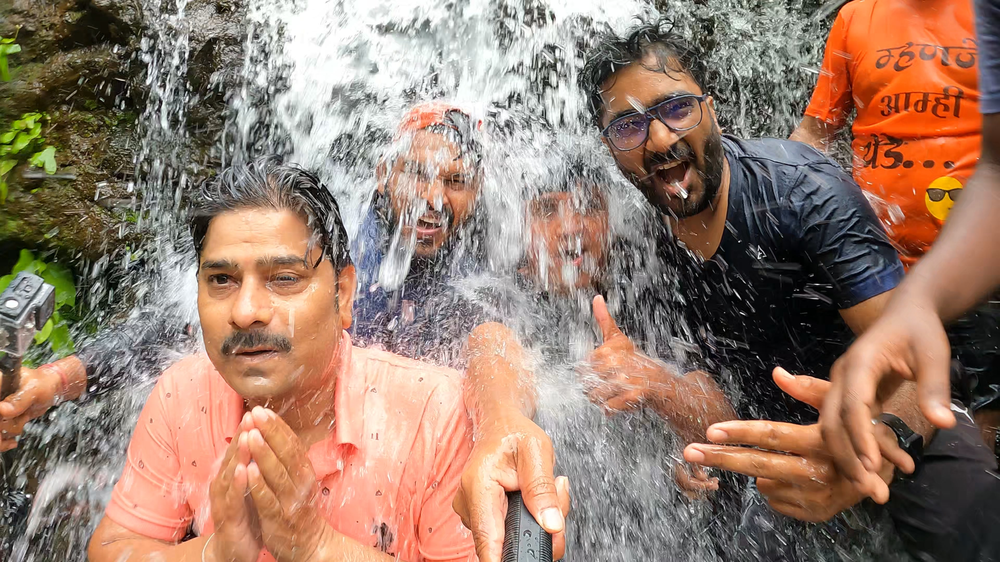

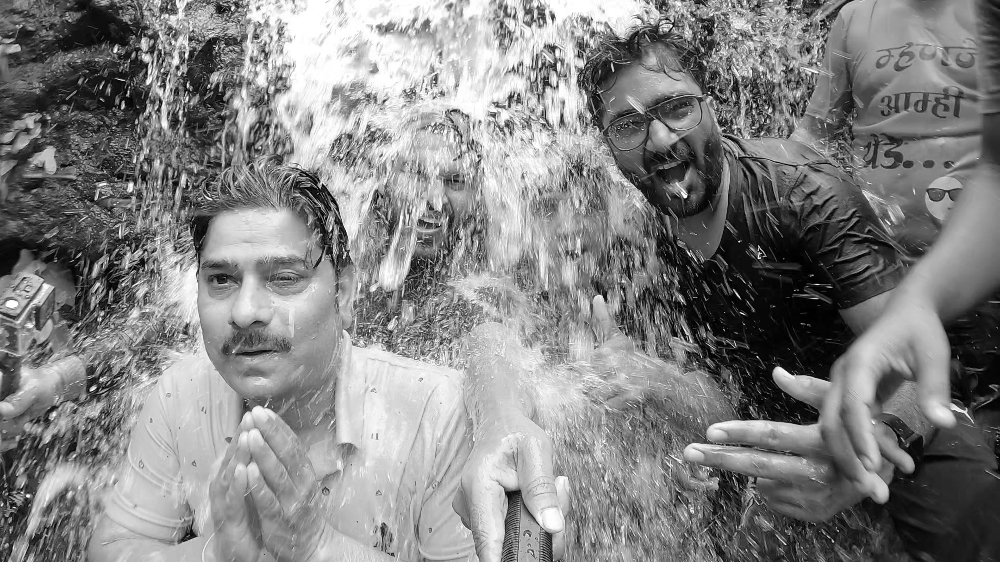

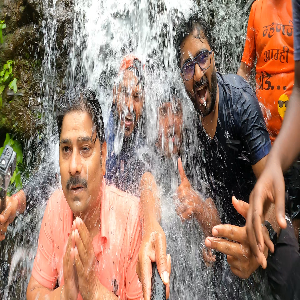

In [2]:
from google.colab.patches import cv2_imshow
import cv2

# Load an image
image = cv2.imread("/content/24234_1659936035813.jpg")

# Convert to grayscale
gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# Resize the image
resized_image = cv2.resize(image, (300, 300))

# Display images
cv2_imshow(image)
cv2_imshow(gray_image)
cv2_imshow(resized_image)


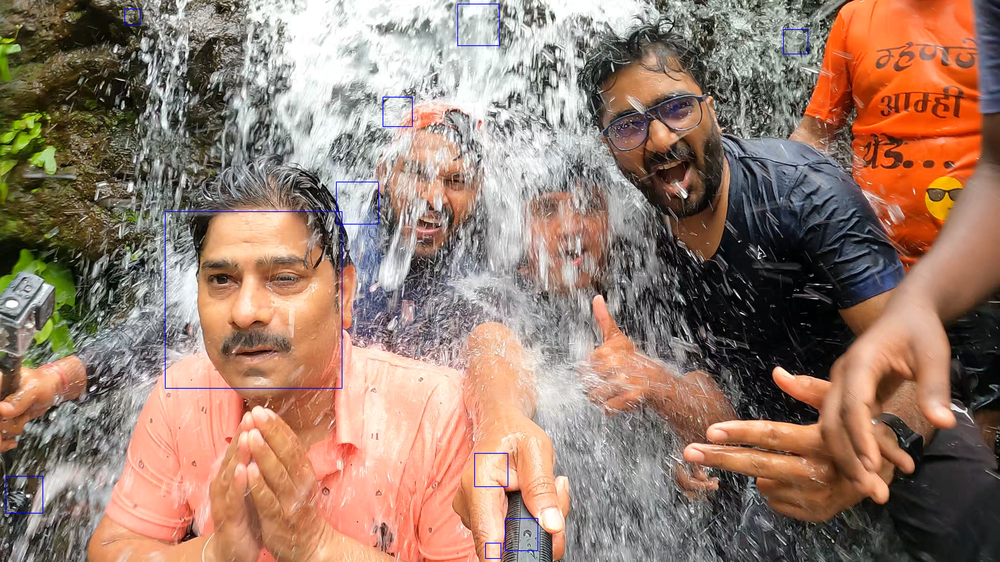

In [4]:
from google.colab.patches import cv2_imshow
import cv2

# Load a pre-trained Haar cascade model for face detection
face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + "haarcascade_frontalface_default.xml")

# Read an image and convert it to grayscale
image = cv2.imread("/content/24234_1659936035813.jpg")
gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# Detect faces in the image
faces = face_cascade.detectMultiScale(gray_image, scaleFactor=1.1, minNeighbors=5)

# Draw rectangles around detected faces
for (x, y, w, h) in faces:
    cv2.rectangle(image, (x, y), (x + w, y + h), (255, 0, 0), 2)

# Display the result
cv2_imshow(image)


In [6]:
from google.colab.patches import cv2_imshow
import cv2

# Initialize video capture
cap = cv2.VideoCapture("video.mp4")

# Check if the video opened successfully
if not cap.isOpened():
    print("Error: Could not open video.")
else:
    # Define an initial tracking window
    ret, frame = cap.read()
    if not ret:
        print("Error: Could not read frame.")
        cap.release()
    else:
        x, y, w, h = 100, 100, 50, 50  # Initial window coordinates
        track_window = (x, y, w, h)

        # Set up the Region of Interest (ROI) for tracking
        roi = frame[y:y + h, x:x + w]
        hsv_roi = cv2.cvtColor(roi, cv2.COLOR_BGR2HSV)
        roi_hist = cv2.calcHist([hsv_roi], [0], None, [180], [0, 180])
        cv2.normalize(roi_hist, roi_hist, 0, 255, cv2.NORM_MINMAX)

        # Define the termination criteria for the tracking
        term_crit = (cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 1)

        # Begin tracking
        while True:
            ret, frame = cap.read()
            if not ret:
                break
            hsv = cv2.cvtColor(frame, cv2.COLOR_BGR2HSV)
            dst = cv2.calcBackProject([hsv], [0], roi_hist, [0, 180], 1)

            # Apply MeanShift to get the new location
            ret, track_window = cv2.meanShift(dst, track_window, term_crit)

            # Draw the tracking window on the frame
            x, y, w, h = track_window
            cv2.rectangle(frame, (x, y), (x + w, y + h), (255, 0, 0), 2)

            # Display frame
            cv2_imshow(frame)
            if cv2.waitKey(30) & 0xFF == ord("q"):
                break

        cap.release()
cv2.destroyAllWindows()


Error: Could not open video.


OpenCV is a powerful tool for computer vision and image processing, providing a comprehensive suite of tools and algorithms for tasks like object detection, tracking, feature extraction, video processing, and 3D vision. Its wide range of applications across industries makes it one of the most versatile and accessible libraries for real-time visual processing and AI.